<a href="https://colab.research.google.com/github/6000671/CG-2023-2/blob/main/VC_S3_Calibracion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# VISIÓN POR COMPUTADOR – Ingeniería en Multimedia
## Semana 3: Calibración de Cámara


In [ ]:
# ------------------------------------------------------------
# 1. Importación de bibliotecas
# ------------------------------------------------------------
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML
from matplotlib import animation

# (Agregar otras según el tema: sympy, scipy, vpython, etc.)


## Análisis de presaberes

Para abordar el presente tema, los estudiantes deben contar con conocimientos previos en:

- Representación digital de imágenes (matrices, píxeles, canales).

- Geometría analítica básica (sistemas de coordenadas y transformaciones).

- Programación en Python y manejo básico de OpenCV.

A continuación, se plantean ejercicios orientados a evidenciar dichas habilidades y conceptos previos.

------------

**EJERCICIO 1**

Si fotografiamos un tablero de ajedrez desde distintos ángulos, ¿las líneas rectas siguen siendo rectas en la imagen?.

Visualice algunas imágenes de un patrón de calibración y analice.

**Revise**: [https://github.com/EveryWhereLab/camera-calibration-using-opencv-python/tree/main/cam1_images](https://github.com/EveryWhereLab/camera-calibration-using-opencv-python/tree/main/cam1_images)

Respuestas al ejercicio 1

In [ ]:
# Las líneas no permanecen perfectamente rectas hacia los bordes de la imagen debido a la distorsión óptica de la lente ya que en cámaras reales aparecen curvaturas hacia los bordes debido a la distorsión radial producida por la lente.
#La magnitud y tipo de curvatura dependen de los parámetros intrínsecos y los coeficientes de distorsión propios de cada cámara.
#Esta deformación no es del objeto, sino del sistema óptico.

- ¿Dónde se nota deformación?

- ¿Es problema del objeto o de la cámara?

- ¿Todas las cámaras deforman igual?

------------

**EJERCICIO 2**

¿Cómo describirías matemáticamente una cámara?

Respuestas al ejercicio 2

In [ ]:
# La cámara utiliza el modelo de Pinhole para proyectas puntos en un espacio 3D en planos 2D. La relación se expresa cómo:
# s [u v 1]^T = K [R | t] [X Y Z 1]^T
# Donde:
# [X Y Z]^T es el punto en el sistema de coordenadas del mundo.
# [R | t] son los parámetros extrínsecos (rotación y traslación que ubican la cámara en el mundo).
# K es la matriz intrínseca.
# [u v] son las coordenadas en píxeles.
# s es un factor de escala.
#La matriz intrínseca K tiene la forma: K =
# K = [ fx 0 cx ]
#     [ 0 fy cy ]
#     [ 0 0 1 ]
# fx y fy representan las distancias focales en píxeles.
# cx y cy son las coordenadas del punto principal (centro óptico proyectado).
# La matriz [R | t] transforma puntos del mundo al sistema de coordenadas de la cámara.
# Después de esta proyección ideal, se aplican los coeficientes de distorsión radial y tangencial.

Análisis del ejercicio 2

In [ ]:
# Una cámara puede modelarse matemáticamente como una transformación proyectiva que convierte puntos tridimensionales del espacio en coordenadas bidimensionales del plano imagen mediante una matriz intrínseca y parámetros extrínsecos.
# La proyección ideal se basa en el modelo pinhole y posteriormente se corrige con parámetros de distorsión que modelan imperfecciones ópticas reales.


## Introducción

En esta sesión estudiaremos cómo modelar matemáticamente una cámara real a partir del modelo geométrico de proyección. Aunque el modelo pinhole describe de manera ideal la formación de la imagen, las cámaras reales incorporan lentes que introducen distorsiones geométricas, principalmente radiales y tangenciales.

La calibración de cámara es el proceso mediante el cual se estiman los parámetros intrínsecos (como la distancia focal y el centro principal) y los coeficientes de distorsión, utilizando un patrón cuyas dimensiones son conocidas. Este procedimiento permite ajustar el modelo matemático a la cámara real y reducir los efectos de deformación presentes en las imágenes capturadas.

La corrección de estas distorsiones es fundamental en aplicaciones como reconstrucción 3D, realidad aumentada, estimación de pose y cualquier sistema que requiera precisión geométrica.


## Modelo geométrico de cámara

La cámara puede modelarse mediante el modelo pinhole, el cual describe la proyección de puntos tridimensionales del mundo sobre un plano bidimensional de imagen. En este modelo ideal, la cámara se representa como un sistema geométrico donde los rayos de luz convergen en un punto denominado centro de proyección y se proyectan sobre el plano imagen.

Para describir matemáticamente esta proyección se definen los parámetros intrínsecos, que caracterizan la geometría interna de la cámara:

- Distancia focal $(fx, fy)$: Representa la relación entre la distancia física focal y la escala en píxeles en los ejes horizontal y vertical. Determina el nivel de ampliación de la imagen y está asociada al ángulo de visión.

- Centro principal $(cx, cy)$: Corresponde al punto donde el eje óptico intersecta el plano de imagen. En una cámara ideal coincide con el centro de la imagen, pero en la práctica puede estar desplazado debido a imperfecciones del sensor o del ensamblaje óptico.

Estos parámetros se organizan en la matriz intrínseca, la cual permite transformar coordenadas en el sistema de la cámara hacia coordenadas en el plano imagen. Estimar correctamente esta matriz es fundamental para lograr correspondencias precisas entre el mundo tridimensional y su representación bidimensional.


## Distorsión de lente

Aunque el modelo pinhole asume una proyección ideal, las cámaras reales utilizan lentes que introducen desviaciones respecto a ese modelo geométrico perfecto. Estas desviaciones se conocen como **distorsiones ópticas** y afectan la correspondencia entre el mundo real y su representación en la imagen.

Las principales formas de distorsión son:

* **Distorsión radial:**
  Se produce debido a la forma y curvatura de las lentes. Los puntos se desplazan radialmente respecto al centro de la imagen, generando efectos como:

  * *Distorsión de barril* (las líneas rectas se curvan hacia afuera).
  * *Distorsión de cojín* (las líneas rectas se curvan hacia adentro).

  Este efecto es más evidente en los bordes de la imagen y aumenta con el uso de lentes gran angular.  Se modelan con $(k_1,k_2,k_3)$

* **Distorsión tangencial:**
  Se origina cuando los elementos ópticos no están perfectamente alineados con el sensor. Produce desplazamientos asimétricos de los puntos, deformando la geometría de la imagen de manera no radial. Se modelan con $(p_1,p_2)$

Estas distorsiones implican que las líneas rectas del mundo real no necesariamente se representen como líneas rectas en la imagen capturada. Por esta razón, deben modelarse y corregirse mediante la estimación de coeficientes de distorsión durante el proceso de calibración.

La corrección de estos efectos es esencial en aplicaciones como reconstrucción 3D, realidad aumentada, estimación de pose y cualquier sistema que dependa de precisión geométrica, ya que pequeñas desviaciones pueden amplificarse en procesos posteriores de análisis o integración virtual.




### Modelo matemático de la distorsión

Sea ((x, y)) la coordenada normalizada de un punto proyectado en el modelo pinhole (es decir, después de dividir por la profundidad y antes de aplicar la matriz intrínseca).

Primero se define:

$$r^2 = x^2 + y^2$$

donde $r$ es la distancia radial al centro óptico.


## Distorsión radial

La corrección radial se modela como:

$$x_{radial} = x \left(1 + k_1 r^2 + k_2 r^4 + k_3 r^6 \right)$$

$$y_{radial} = y \left(1 + k_1 r^2 + k_2 r^4 + k_3 r^6 \right)$$

Observaciones:

- Si $k_1 < 0$ : distorsión de barril.
- Si $k_1 > 0$ : distorsión de cojín.
- Los términos de orden superior refinan la corrección.


##  Distorsión tangencial

Modela el efecto de desalineación entre lente y sensor:

$$x_{tangencial} = x + \left[ 2p_1xy + p_2(r^2 + 2x^2) \right]$$

$$y_{tangencial} = y + \left[ p_1(r^2 + 2y^2) + 2p_2xy \right]$$

Aquí:

* $p_1$ y $p_2$ generan desplazamientos no simétricos.
* Su efecto suele ser menor que el radial, pero relevante en calibraciones precisas.


##  Coordenadas finales

Las coordenadas corregidas se obtienen combinando ambos efectos y luego aplicando la matriz intrínseca:

$$
\begin{bmatrix}
u \\
v \\
1
\end{bmatrix}
= K
\begin{bmatrix}
x_{corr} \\
y_{corr} \\
1
\end{bmatrix}
$$

donde $K$ es la matriz intrínseca.


## Formulación del problema de calibración

El proceso de calibración puede entenderse como un problema de estimación de parámetros dentro de un modelo geométrico.

- Conocemos las coordenadas 3D reales de los puntos del patrón de calibración (generalmente sobre el plano (Z = 0)).
- Detectamos automáticamente las coordenadas 2D correspondientes en la imagen capturada.

Se dispone de un conjunto de correspondencias:

$$(X_i, Y_i, Z_i) \quad \longleftrightarrow \quad (u_i, v_i)$$

El modelo de cámara establece que la proyección ideal puede expresarse como:

$$s \begin{bmatrix}
u \\
v \\
1
\end{bmatrix}
= K
\left[ R \mid t \right]
\begin{bmatrix}
X \\
Y \\
Z \\
1
\end{bmatrix} $$

donde:

- $K$ es la matriz intrínseca,
- $R$ y $t$ son los parámetros extrínsecos (rotación y traslación),
- $s$ es un factor de escala asociado a la proyección.

Sin embargo, debido a la distorsión óptica, la proyección real no coincide exactamente con este modelo ideal. Por ello, el problema de calibración consiste en:

> Estimar los parámetros intrínsecos, extrínsecos y los coeficientes de distorsión que mejor ajusten el modelo matemático a las observaciones reales.

Esto se logra minimizando el **error de reproyección**, definido como la distancia entre:

- los puntos detectados en la imagen, y
- los puntos proyectados usando el modelo estimado.

Formalmente, se minimiza una función del tipo:

$$\min_{\theta} \sum_{i=1}^{N} \left| \mathbf{u}_i - \hat{\mathbf{u}}_i(\theta) \right|^2$$

donde:

* $\mathbf{u}_i$ son los puntos observados,
* $\hat{\mathbf{u}}_i(\theta)$ son los puntos proyectados por el modelo,
* $\theta$ representa el conjunto de parámetros desconocidos.

En términos prácticos, la calibración es un problema de optimización no lineal cuyo objetivo es encontrar el modelo de cámara que produzca la menor discrepancia entre la proyección teórica y los datos observados.



In [ ]:
# Código explicativo

## Implementación computacional



In [ ]:
# Importar módulos
import numpy as np
import cv2 as cv
import glob
import yaml
from pathlib import Path
from skimage import io
from google.colab.patches import cv2_imshow # para visualizar imágenes

### Geometría del patrón


Se define la geometría real del tablero de calibración. Se especifica el número de esquinas internas en las direcciones horizontal y vertical, así como el tamaño físico de cada cuadrado.

A partir de estos parámetros se construyen las coordenadas 3D del patrón en el sistema de referencia del mundo, asumiendo que todos los puntos se encuentran sobre el plano $Z=0$. Estas coordenadas representan la ubicación real de cada esquina del tablero y servirán como referencia para estimar los parámetros de la cámara.

In [ ]:
CHESSBOARD_CORNER_NUM_X = 9
CHESSBOARD_CORNER_NUM_Y = 6
SQUARE_WIDTH = 0.05

objp = np.zeros((CHESSBOARD_CORNER_NUM_X*CHESSBOARD_CORNER_NUM_Y,3), np.float32)


for i in range( CHESSBOARD_CORNER_NUM_Y ) :
    for j in range( CHESSBOARD_CORNER_NUM_X ) :
        objp[i*CHESSBOARD_CORNER_NUM_X+j,0]=j*SQUARE_WIDTH
        objp[i*CHESSBOARD_CORNER_NUM_X+j,1]=i*SQUARE_WIDTH

# Nombre para el archivo de calibración
CAMERA_PARAMETERS_OUTPUT_FILE = "cam1.yaml"

print('Las primeras coordenadas: \n')
objp[0:15]

Las primeras coordenadas: 



array([[0.  , 0.  , 0.  ],
       [0.05, 0.  , 0.  ],
       [0.1 , 0.  , 0.  ],
       [0.15, 0.  , 0.  ],
       [0.2 , 0.  , 0.  ],
       [0.25, 0.  , 0.  ],
       [0.3 , 0.  , 0.  ],
       [0.35, 0.  , 0.  ],
       [0.4 , 0.  , 0.  ],
       [0.  , 0.05, 0.  ],
       [0.05, 0.05, 0.  ],
       [0.1 , 0.05, 0.  ],
       [0.15, 0.05, 0.  ],
       [0.2 , 0.05, 0.  ],
       [0.25, 0.05, 0.  ]], dtype=float32)

### Construcción del conjunto de datos para calibración

En este bloque se definen los criterios de terminación para el algoritmo de refinamiento de esquinas, los cuales controlan cuándo detener el proceso iterativo (ya sea por alcanzar un número máximo de iteraciones o por lograr una precisión mínima).

In [ ]:

# termination criteria
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)
# Arrays to store object points and image points from all the images.
objpoints = [] # 3d point in real world space
imgpoints = [] # 2d points in image plane.

images = [('https://github.com/EveryWhereLab/camera-calibration-using-opencv-python/blob/main/cam1_images/' +str(n)+ '.jpg?raw=true') for n in range(34)]

print('Las primeras imágenes: \n')

images[:4]

Las primeras imágenes: 



['https://github.com/EveryWhereLab/camera-calibration-using-opencv-python/blob/main/cam1_images/0.jpg?raw=true',
 'https://github.com/EveryWhereLab/camera-calibration-using-opencv-python/blob/main/cam1_images/1.jpg?raw=true',
 'https://github.com/EveryWhereLab/camera-calibration-using-opencv-python/blob/main/cam1_images/2.jpg?raw=true',
 'https://github.com/EveryWhereLab/camera-calibration-using-opencv-python/blob/main/cam1_images/3.jpg?raw=true']

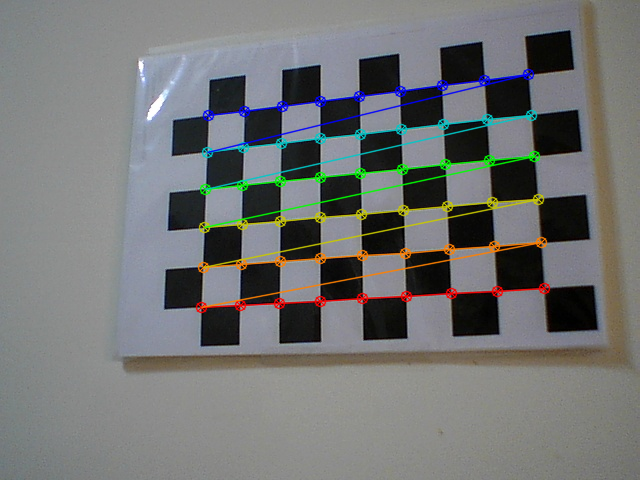

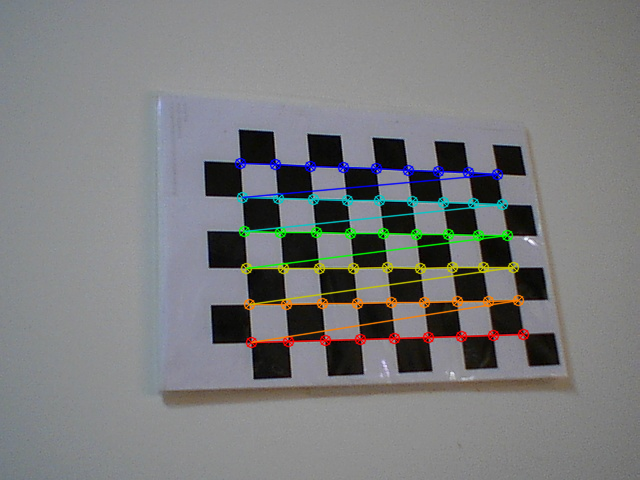

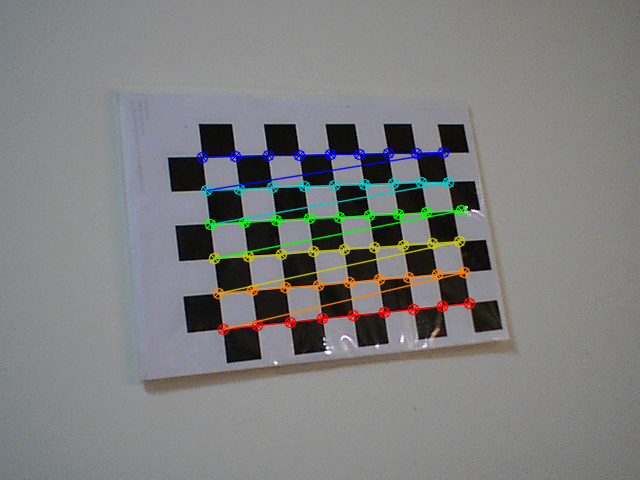

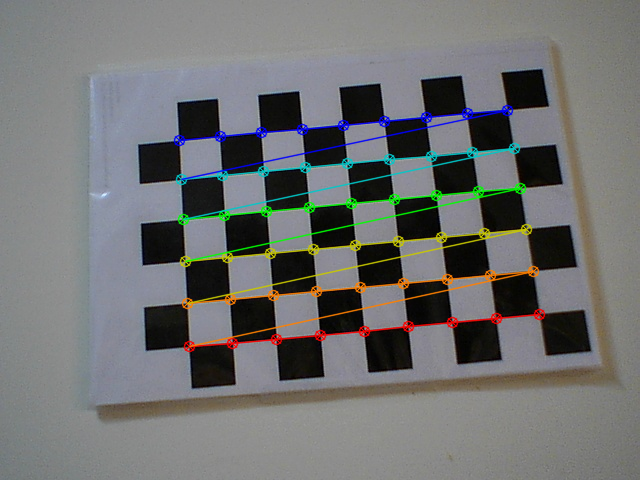

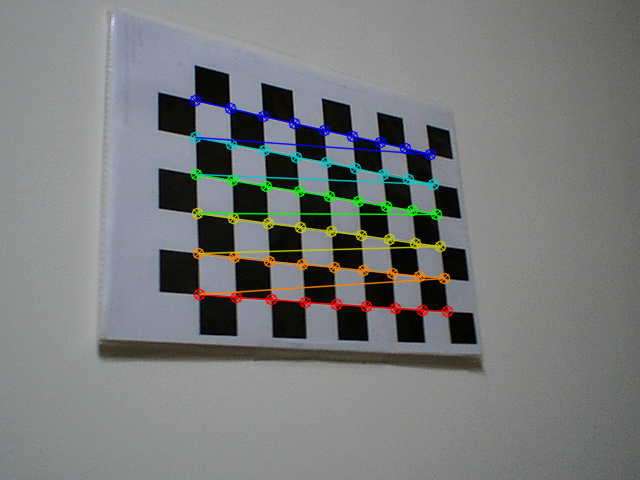

...

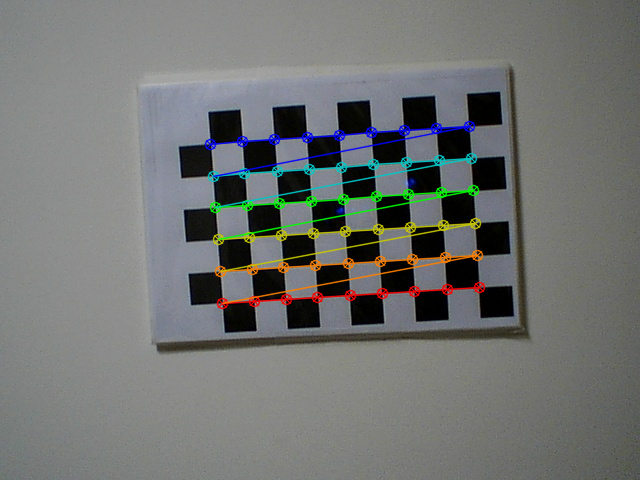

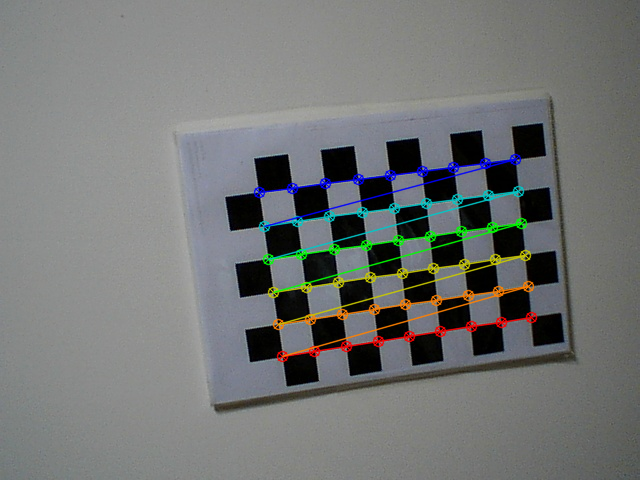

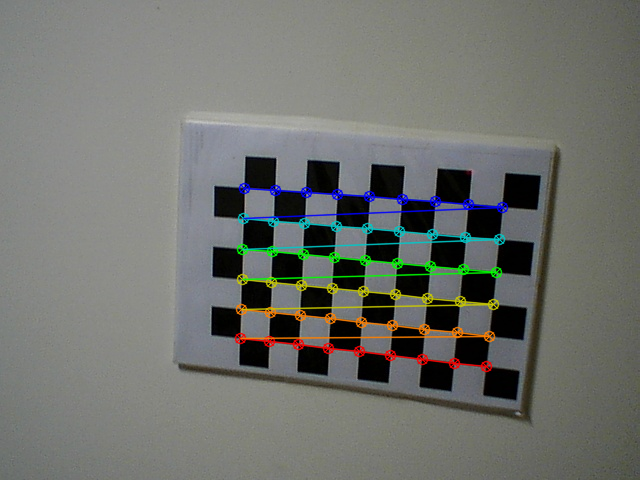

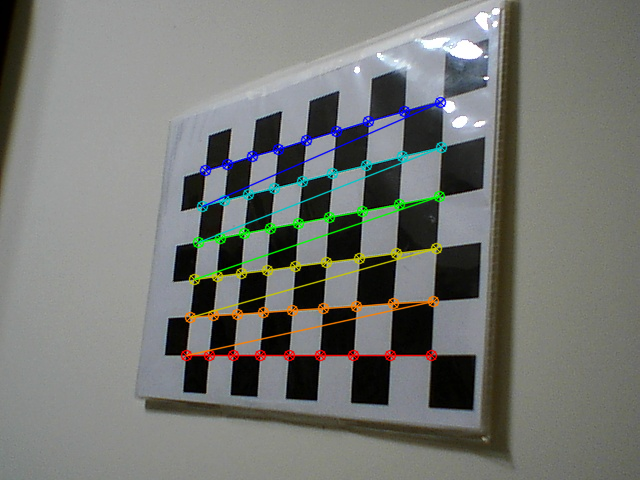

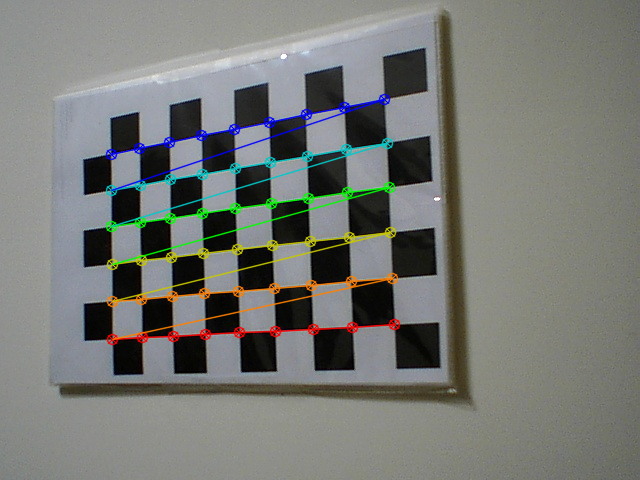

In [ ]:
for fname in images:
    img = cv.cvtColor(io.imread(fname), cv.COLOR_BGR2RGB) # lee imagen en formato RGB
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    # Find the chess board corners
    ret, corners = cv.findChessboardCorners(gray, (CHESSBOARD_CORNER_NUM_X,CHESSBOARD_CORNER_NUM_Y), None)
    # If found, add object points, image points (after refining them)
    if ret == True:
        objpoints.append(objp)
        corners2 = cv.cornerSubPix(gray,corners, (11,11), (-1,-1), criteria)
        imgpoints.append(corners)
        # Draw and display the corners
        cv.drawChessboardCorners(img, (CHESSBOARD_CORNER_NUM_X,CHESSBOARD_CORNER_NUM_Y), corners2, ret)
        cv2_imshow(img)
        # cv.waitKey(500)
    else:
        print('Failed to find a chessboard in {}'.format(fname))

### Estimación de parámetros y evaluación del modelo

El proceso de calibración utilizando las correspondencias entre puntos 3D del patrón $objpoints$ y sus proyecciones 2D detectadas en las imágenes $imgpoints$.

La función cv.calibrateCamera() estima:

- mtx: matriz intrínseca de la cámara.

- dist: coeficientes de distorsión.

- rvecs y tvecs: parámetros extrínsecos (rotación y traslación) para cada imagen utilizada.

Se calcula el error medio de reproyección indicando qué tan bien el modelo estimado reproduce los puntos observados en la imagen.

In [ ]:

ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
print("Matriz de la cámara \n", mtx, "\n Coeficientes de distorsión coefficients : \n", dist)
mean_error = 0
for i in range(len(objpoints)):
    imgpoints2, _ = cv.projectPoints(objpoints[i], rvecs[i], tvecs[i], mtx, dist)
    error = cv.norm(imgpoints[i], imgpoints2, cv.NORM_L2)/len(imgpoints2)
    mean_error += error
print( "total error: {}".format(mean_error/len(objpoints)) )
data = {'camera_matrix': np.asarray(mtx).tolist(), 'dist_coeff': np.asarray(dist).tolist()}
with open(CAMERA_PARAMETERS_OUTPUT_FILE, "w") as f:
    yaml.dump(data, f)

Matriz de la cámara 
 [[763.06548756   0.         320.42951626]
 [  0.         765.66830862 267.88553433]
 [  0.           0.           1.        ]] 
 Coeficientes de distorsión coefficients : 
 [[-6.17717424e-02 -2.49241236e-01  3.97628821e-03  1.49659350e-05
   1.75406563e+00]]
total error: 0.04552081767385606


### Des-distorsione las imágenes

Una vez obtenido un modelo para la cámara, puede usarse para eliminar la distorsión geométrica de las imágenes. Se utiliza la función cv.getOptimalNewCameraMatrix() para calcular una nueva matriz intrínseca ajustada, teniendo en cuenta los coeficientes de distorsión estimados previamente.

Esta nueva matriz permite optimizar la corrección geométrica, equilibrando:

- la eliminación de distorsión,

- la preservación del campo visual,

- la minimización de regiones negras en los bordes.

El resultado (newcameramtx) será utilizado para generar una versión corregida de la imagen.

In [ ]:
img = cv.cvtColor(io.imread(fname), cv.COLOR_BGR2RGB) # lee imagen en formato RGB
h,  w = img.shape[:2]
newcameramtx, roi = cv.getOptimalNewCameraMatrix(mtx, dist, (w,h), 1, (w,h))
newcameramtx

array([[755.77984113,   0.        , 320.42340771],
       [  0.        , 758.28161651, 269.02057159],
       [  0.        ,   0.        ,   1.        ]])

Se aplica la corrección geométrica a la imagen original utilizando los parámetros estimados durante la calibración.

La función cv.undistort() utiliza:

- la matriz intrínseca original (mtx),

- los coeficientes de distorsión (dist),

- y la nueva matriz optimizada (newcameramtx),

para generar una imagen rectificada (dst), en la cual las deformaciones producidas por la lente han sido compensadas.

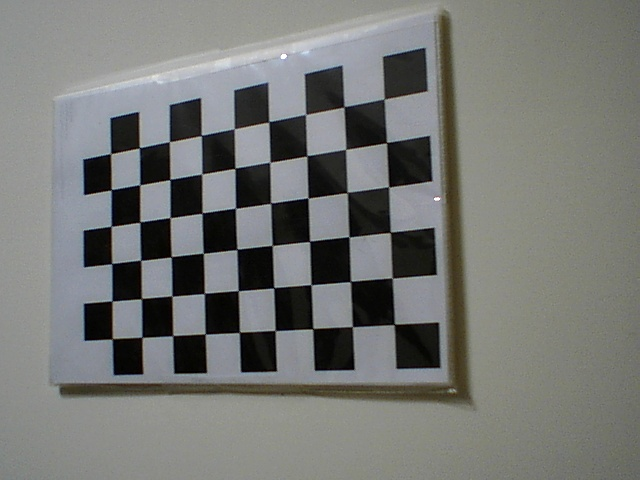

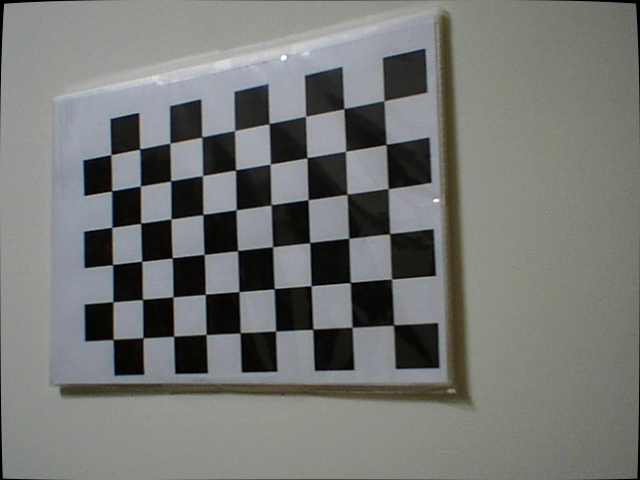

In [ ]:
# undistort
dst = cv.undistort(img, mtx, dist, None, newcameramtx)
# crop the image
x, y, w, h = roi
# dst = dst[y:y+h, x:x+w]
cv2_imshow(img)
cv2_imshow(dst)
#cv.imwrite('calibresult.png', dst)

### Actividad práctica

- Capture al menos 30 imágenes de un patrón de calibración desde diferentes posiciones y orientaciones. Procure variar la inclinación, distancia y ubicación del patrón dentro del encuadre.

- Estime los parámetros intrínsecos y los coeficientes de distorsión utilizando el procedimiento desarrollado en clase.

- Calcule el error medio de reproyección y analice su magnitud.

- Corrija al menos una imagen utilizando los coeficientes obtenidos y compare visualmente el resultado con la imagen original.

Entregable:

- Matriz intrínseca estimada.

- Coeficientes de distorsión.

- Valor del error medio.

- Imagen original vs imagen corregida.

- Breve análisis sobre la calidad de la calibración obtenida.

## Análisis y discusión

- Describe el comportamiento observado en la simulación.  
- ¿Qué ocurre si modificas la aceleración o las condiciones iniciales?  
- Compara los resultados con las ecuaciones teóricas.  


## Actividad práctica

**Instrucción:**  
Modifica el código para simular el movimiento de un objeto con una velocidad inicial diferente y grafica el resultado comparado con el caso base.

**Puntos a desarrollar:**
1. Definir nuevas condiciones iniciales.  
2. Graficar ambas trayectorias.  
3. Analizar la diferencia.


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Imágenes encontradas: 30
Matriz intrínseca:
 [[2.92775194e+03 0.00000000e+00 1.51477300e+03]
 [0.00000000e+00 2.92941785e+03 2.01802871e+03]
 [0.00000000e+00 0.00000000e+00 1.00000000e+00]]

Coeficientes de distorsión:
 [[ 7.26690137e-02  3.41850090e-01  1.19852766e-03  1.07768573e-03
  -1.42665660e+00]]
Error medio de reproyección: 0.07826984661801664


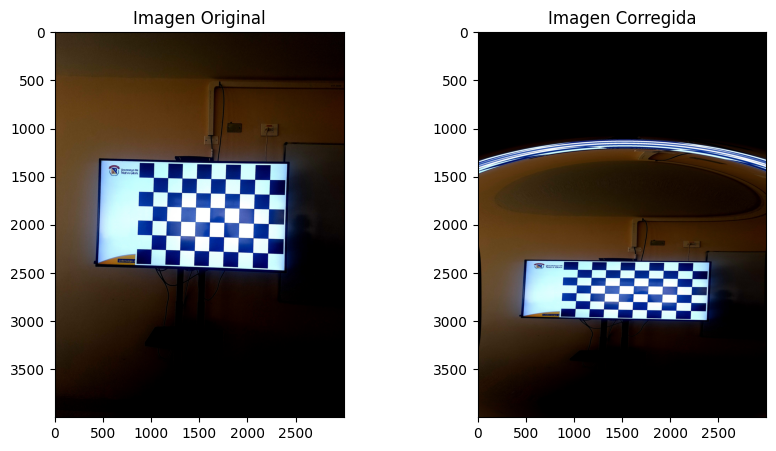

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# =============================
# 2. Librerías
# =============================
import numpy as np
import cv2 as cv
import glob
import matplotlib.pyplot as plt

# =============================
# 3. Tamaño del tablero
# (Cambiar si es diferente)
# =============================
CHESSBOARD_CORNER_NUM_X = 9
CHESSBOARD_CORNER_NUM_Y = 6

# =============================
# 4. Puntos del mundo real
# =============================
objp = np.zeros((CHESSBOARD_CORNER_NUM_X * CHESSBOARD_CORNER_NUM_Y, 3), np.float32)
objp[:, :2] = np.mgrid[0:CHESSBOARD_CORNER_NUM_X,
                       0:CHESSBOARD_CORNER_NUM_Y].T.reshape(-1, 2)

objpoints = []
imgpoints = []

# =============================
# 5. Cargar imágenes
# =============================
image_path = "/content/drive/MyDrive/Img/*.jpg"
images = glob.glob(image_path)

print("Imágenes encontradas:", len(images))

# =============================
# 6. Detectar esquinas
# =============================
criteria = (cv.TERM_CRITERIA_EPS + cv.TERM_CRITERIA_MAX_ITER, 30, 0.001)

for fname in images:
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    ret, corners = cv.findChessboardCorners(
        gray,
        (CHESSBOARD_CORNER_NUM_X, CHESSBOARD_CORNER_NUM_Y),
        None
    )

    if ret:
        objpoints.append(objp)
        corners2 = cv.cornerSubPix(
            gray, corners, (11,11), (-1,-1), criteria
        )
        imgpoints.append(corners2)

# =============================
# 7. Calibración
# =============================
ret, mtx, dist, rvecs, tvecs = cv.calibrateCamera(
    objpoints,
    imgpoints,
    gray.shape[::-1],
    None,
    None
)

print("Matriz intrínseca:\n", mtx)
print("\nCoeficientes de distorsión:\n", dist)

mean_error = 0

for i in range(len(objpoints)):
    imgpoints2, _ = cv.projectPoints(
        objpoints[i],
        rvecs[i],
        tvecs[i],
        mtx,
        dist
    )

    error = cv.norm(imgpoints[i], imgpoints2, cv.NORM_L2) / len(imgpoints2)
    mean_error += error

mean_error = mean_error / len(objpoints)

print("Error medio de reproyección:", mean_error)

img = cv.imread(images[0])
h, w = img.shape[:2]

newcameramtx, roi = cv.getOptimalNewCameraMatrix(
    mtx, dist, (w,h), 1, (w,h)
)

dst = cv.undistort(img, mtx, dist, None, newcameramtx)

plt.figure(figsize=(10,5))

plt.subplot(1,2,1)
plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
plt.title("Imagen Original")

plt.subplot(1,2,2)
plt.imshow(cv.cvtColor(dst, cv.COLOR_BGR2RGB))
plt.title("Imagen Corregida")

plt.show()


### Reto para multimedia

Utilizando los parámetros estimados en la calibración de su cámara:

- Defina un conjunto simple de puntos 3D (por ejemplo, los vértices de un cubo apoyado sobre el patrón).

- Proyecte dichos puntos sobre la imagen utilizando cv.projectPoints.

- Dibuje el cubo sobre la imagen corregida.

**Objetivo**:
Verificar que la proyección 3D sea coherente con la geometría de la escena real.

Reflexione:

- ¿El cubo parece realmente apoyado sobre el tablero?

- ¿Qué ocurre si la calibración no es precisa?

- ¿Cómo se relaciona esto con aplicaciones de realidad aumentada?

In [ ]:
# tamaño del cubo (en unidades del tablero)
cube_size = 3

# vértices del cubo
axis = np.float32([
    [0,0,0],
    [cube_size,0,0],
    [cube_size,cube_size,0],
    [0,cube_size,0],
    [0,0,-cube_size],
    [cube_size,0,-cube_size],
    [cube_size,cube_size,-cube_size],
    [0,cube_size,-cube_size]
])
def draw_cube(img, imgpts):
    imgpts = np.int32(imgpts).reshape(-1,2)

    # base del cubo (verde)
    img = cv.drawContours(img, [imgpts[:4]], -1, (0,255,0), -3)

    # columnas (azul)
    for i,j in zip(range(4), range(4,8)):
        img = cv.line(img, tuple(imgpts[i]), tuple(imgpts[j]), (255,0,0), 3)

    # tapa del cubo (rojo)
    img = cv.drawContours(img, [imgpts[4:]], -1, (0,0,255), 3)

    return img

for fname in images:
    img = cv.imread(fname)
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)

    ret, corners = cv.findChessboardCorners(
        gray,
        (CHESSBOARD_CORNER_NUM_X, CHESSBOARD_CORNER_NUM_Y),
        None
    )

    if ret:
        corners2 = cv.cornerSubPix(
            gray, corners, (11,11), (-1,-1), criteria
        )

        # obtener pose de la cámara
        ret, rvec, tvec = cv.solvePnP(objp, corners2, mtx, dist)

        # proyectar cubo
        imgpts, _ = cv.projectPoints(axis, rvec, tvec, mtx, dist)

        img = draw_cube(img, imgpts)

        plt.imshow(cv.cvtColor(img, cv.COLOR_BGR2RGB))
        plt.title("Cubo proyectado")
        plt.axis('off')
        plt.show()

        break

NameError: name 'np' is not defined

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Conclusiones

- Resume los resultados obtenidos.  
- Menciona los posibles errores numéricos o de modelo.  
- Explica cómo se podría extender esta simulación a un entorno 3D o interactivo.


# Autoevaluación

| Criterio  | Cumple | Observaciones         |
|---------- | ------ | --------------------- |
| Definió correctamente la geometría del patrón de calibración        |        |               |
| Detectó adecuadamente las esquinas en múltiples imágenes            |        |               |
| Estimó la matriz intrínseca y los coeficientes de distorsión        |        |               |
| Calculó e interpretó el error medio de reproyección                 |        |               |
| Aplicó correctamente la corrección de distorsión                    |        |               |
| Analizó visualmente la diferencia entre imagen original y corregida |        |               |
| Proyectó correctamente un objeto 3D sobre el patrón      |        |               |
| Presentó conclusiones técnicas claras y coherentes                  |        |               |

